In [1]:
using ScikitLearn, DecisionTree, MLDataUtils, CSV, DataFrames,Plots, CategoricalArrays
using MLDataUtils, StatsBase, Clustering
using StableRNGs, ParallelKMeans
using Gurobi, JuMP
using Random

In [2]:
data = CSV.read("Cleaning/clustering_data.csv", DataFrame, pool=true);

We remove the sales price of the dataset for the logisitic regression as it is 100% correlated with whether a painting is sold or not 

In [3]:
# remove sales_price from data
data = data[:, Not(:sales_price)];

In [51]:
# # suffle data
# data = shuffle(data);

Separate into X and y

In [4]:
# X is all features except 'sold' binary variable
X = data[:, Not(:sold)];
y = data.sold;

Set seed and split data

In [5]:
#Create train, val and test set 
seed = 42
(X2, y2), (X_test, y_test) = IAI.split_data(:classification, X, y, seed=seed, train_proportion=0.8)
(X_train, y_train), (X_valid, y_valid) =  IAI.split_data(:classification, X2, y2, seed=seed, train_proportion=0.8);

### Hyperparameters for tuning

In [6]:
# hyperparameters
max_depth = [2, 3, 4, 5]
minbucket = [1, 5, 10, 20, 50]
num_trees = [20, 25, 50, 100, 150]
num_estimators = [20, 25, 50, 100, 150]
sparsity = 1:10;

## CART

In [7]:
#CART model
cart = IAI.OptimalTreeClassifier(
        random_seed=seed, 
        localsearch=false,
        criterion=:gini) 


grid_cart = IAI.GridSearch(cart,
        max_depth = max_depth,
        minbucket = minbucket)

IAI.fit_cv!(grid_cart, X2,Array(y2), validation_criterion = :auc,n_folds =5)

┌ Warning: This copy of Interpretable AI software is for academic purposes only and not for commercial use.
└ @ nothing nothing:nothing


All Grid Results:

 Row │ minbucket  max_depth  cp           split1_train_score  split2_train_score  split3_train_score  split4_train_score  split5_train_score  mean_train_score  std_train_score  split1_valid_score  split2_valid_score  split3_valid_score  split4_valid_score  split5_valid_score  mean_valid_score  std_valid_score  split1_cp    split2_cp    split3_cp    split4_cp    split5_cp    mean_cp      std_cp       overall_valid_score  rank_valid_score
     │ Int64      Int64      Float64      Float64             Float64             Float64             Float64             Float64             Float64           Float64          Float64             Float64             Float64             Float64             Float64             Float64           Float64          Float64      Float64      Float64      Float64      Float64      Float64      Float64      Float64              Int64
─────┼───────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
   1 │         1          2  0.00381765            0.0813615           0.0793643           0.0796777           0.0794331           0.0806444         0.0800962      0.000873513            0.811643            0.829549            0.818312            0.817459            0.813995          0.818191       0.00689294  0.00570662   0.00381765   0.00550742   0.004584     0.00493493   0.00491012   0.000756907             0.818191                16
   2 │         1          3  0.00106378            0.0982743           0.0938793           0.0987966           0.0960232           0.0987169         0.097138       0.00214457             0.869444            0.891083            0.86498             0.852694            0.863454          0.868331       0.0141284   0.00131515   0.00109939   0.0012262    0.00109156   0.00106378   0.00115922   0.000107315             0.868331                11
   3 │         1          4  0.000672598           0.111929            0.105923            0.113119            0.108868            0.110548          0.110078       0.00281157             0.889169            0.917569            0.873132            0.877727            0.881605          0.887841       0.0176284   0.000996752  0.000741106  0.000961383  0.000725677  0.000672598  0.000819503  0.000148389             0.887841                 6
   4 │         1          5  0.00089551            0.142502            0.125378            0.137913            0.129733            0.127217          0.132548       0.00734198             0.886121            0.919933            0.876515            0.893111            0.890823          0.893301       0.0161922   0.00192543   0.00109881   0.00121921   0.000236432  0.000839681  0.00106391   0.000612895             0.892832                 1
   5 │         5          2  0.00381765            0.0813615           0.0793643           0.0796777           0.0794331           0.0806444         0.0800962      0.000873513            0.811643            0.829549            0.818312            0.817459            0.813995          0.818191       0.00689294  0.00570662   0.00381765   0.00550742   0.004584     0.00493493   0.00491012   0.000756907             0.818191                17
   6 │         5          3  0.00106378            0.0982743           0.0938793           0.0987966           0.0960232           0.0987169         0.097138       0.00214457             0.869444            0.891083            0.86498             0.852694            0.863454          0.868331       0.0141284   0.00131515   0.00109939   0.0012262    0.00109156   0.00106378   0.00115922   0.000107315             0.868331                12
   7 │         5      

In [9]:
IAI.score(grid_cart,X2,y2,criterion=:auc)

0.9040097939781379

In [14]:
lnr_cart = IAI.get_learner(grid_cart)

IAI.set_threshold!(lnr_cart, 1, 0.95, simplify=true)

cart_train_auc = IAI.score(lnr_cart, X_train, y_train ,criterion=:auc)
cart_test_auc = IAI.score(lnr_cart, X_test, y_test ,criterion=:auc)
cart_val_auc = IAI.score(lnr_cart, X_valid, y_valid ,criterion=:auc)


cart_train_acc = IAI.score(lnr_cart, X_train, y_train, criterion=:accuracy, positive_label=1)
cart_test_acc = IAI.score(lnr_cart, X_test, y_test, criterion=:accuracy, positive_label=1)
cart_val_acc = IAI.score(lnr_cart, X_valid, y_valid ,criterion=:accuracy, positive_label =1)

print("CART train AUC: ", cart_train_auc, "\n")
print("CART test AUC: ", cart_test_auc, "\n")
print("CART valid AUC: ", cart_val_auc, "\n")
print("--- \n")
print("CART train accuracy: ", cart_train_acc, "\n")
print("CART test accuracy: ", cart_test_acc, "\n")
print("CART valid accuracy: ", cart_val_acc, "\n")

CART train AUC: 0.8992995818648494
CART test AUC: 0.8981453817167102
CART valid AUC: 0.8981698638923968
--- 
CART train accuracy: 0.8740877285381085
CART test accuracy: 0.872261016132916
CART valid accuracy: 0.8746425884123401


In [15]:
IAI.write_json("Models/Threshold/CART.json",lnr_cart)

137910

## Optimal Classification Trees

In [16]:
#OCT model 
oct = IAI.OptimalTreeClassifier(
        random_seed=seed,
        criterion=:gini) 

grid_oct = IAI.GridSearch(
    oct,
    max_depth = max_depth,
    minbucket = minbucket)

IAI.fit_cv!(grid_oct, X2,Array(y2), validation_criterion = :auc, n_folds = 5)

All Grid Results:

 Row │ minbucket  max_depth  cp           split1_train_score  split2_train_score  split3_train_score  split4_train_score  split5_train_score  mean_train_score  std_train_score  split1_valid_score  split2_valid_score  split3_valid_score  split4_valid_score  split5_valid_score  mean_valid_score  std_valid_score  split1_cp    split2_cp    split3_cp    split4_cp    split5_cp    mean_cp      std_cp       overall_valid_score  rank_valid_score
     │ Int64      Int64      Float64      Float64             Float64             Float64             Float64             Float64             Float64           Float64          Float64             Float64             Float64             Float64             Float64             Float64           Float64          Float64      Float64      Float64      Float64      Float64      Float64      Float64      Float64              Int64
─────┼───────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
   1 │         1          2  0.00381765            0.0813615           0.0793643           0.0796777           0.0794331           0.0806444         0.0800962      0.000873513            0.811643            0.829549            0.818312            0.817459            0.813995          0.818191       0.00689294  0.00570662   0.00381765   0.00550742   0.004584     0.00493493   0.00491012   0.000756907             0.818191                16
   2 │         1          3  0.0012262             0.0998185           0.0949355           0.10066             0.097547            0.100523          0.0986968      0.0024453              0.878294            0.902303            0.86377             0.860675            0.86534           0.874077       0.0171514   0.00198287   0.00173554   0.0012262    0.00203029   0.00185055   0.00176509   0.000322621             0.874077                12
   3 │         1          4  0.000708779           0.125053            0.115813            0.123835            0.122196            0.118216          0.121023       0.00389073             0.879154            0.90804             0.884466            0.892503            0.882586          0.88935        0.0115414   0.00201221   0.00277586   0.00119981   0.00057122   0.000845576  0.00148093   0.000904069             0.88908                  9
   4 │         1          5  0.000862933           0.154361            0.147675            0.151573            0.151961            0.14703           0.15052        0.00309073             0.890143            0.908291            0.885991            0.886463            0.888101          0.891798       0.00936235  0.00118975   0.00144666   0.000456007  0.00107364   0.000839395  0.00100109   0.00037505              0.890572                 7
   5 │         5          2  0.00381765            0.0813615           0.0793643           0.0796777           0.0794331           0.0806444         0.0800962      0.000873513            0.811643            0.829549            0.818312            0.817459            0.813995          0.818191       0.00689294  0.00570662   0.00381765   0.00550742   0.004584     0.00493493   0.00491012   0.000756907             0.818191                17
   6 │         5          3  0.00173554            0.0998185           0.0949355           0.10066             0.097547            0.100523          0.0986968      0.0024453              0.878294            0.902303            0.863635            0.860675            0.86534           0.87405        0.0171717   0.00198287   0.00173554   0.0021335    0.00203029   0.00185055   0.00194655   0.000155743             0.87405                 13
   7 │         5      

In [ ]:
IAI.score(grid_oct,X2,y2,criterion=:auc)

0.9286825077180805

In [18]:
lnr_oct = IAI.get_learner(grid_oct)

IAI.set_threshold!(lnr_oct, 1, 0.95, simplify=true)

oct_train_auc = IAI.score(lnr_oct, X_train, y_train ,criterion=:auc)
oct_test_auc = IAI.score(lnr_oct, X_test, y_test ,criterion=:auc)
oct_val_auc = IAI.score(lnr_oct, X_valid, y_valid ,criterion=:auc)


oct_train_acc = IAI.score(lnr_oct, X_train, y_train, criterion=:accuracy, positive_label=1)
oct_test_acc = IAI.score(lnr_oct, X_test, y_test, criterion=:accuracy, positive_label=1)
oct_val_acc = IAI.score(lnr_oct, X_valid, y_valid ,criterion=:accuracy, positive_label =1)

print("OCT train AUC: ", oct_train_auc, "\n")
print("OCT test AUC: ", oct_test_auc, "\n")
print("OCT valid AUC: ", oct_val_auc, "\n")
print("--- \n")
print("OCT train accuracy: ", oct_train_acc, "\n")
print("OCT test accuracy: ", oct_test_acc, "\n")
print("OCT valid accuracy: ", oct_val_acc, "\n")

OCT train AUC: 0.924609042242229
OCT test AUC: 0.920880841829587
OCT valid AUC: 0.9114715924656389
--- 
OCT train accuracy: 0.8650214430817846
OCT test accuracy: 0.8656392968938117
OCT valid accuracy: 0.8633559066967644


In [19]:
IAI.write_json("Models/Threshold/OCT.json",lnr_oct)

6385791

## RandomForest

In [20]:
#Random Forest

rf = IAI.RandomForestClassifier(
    random_seed=seed,
    criterion=:gini)

grid_rf = IAI.GridSearch(
    rf,
    max_depth = max_depth,
    minbucket =minbucket,
    num_trees=num_trees)

IAI.fit_cv!(grid_rf, X2, Array(y2), validation_criterion = :auc, n_folds = 5)

LoadError: InterruptException:

In [ ]:
IAI.score(grid_rf,X2,y2,criterion=:auc)

0.9567674858223083

In [ ]:
lnr_rf = IAI.get_learner(grid_rf)

IAI.set_threshold!(lnr_rf, 1, 0.95, simplify=true)

rf_train_auc = IAI.score(lnr_rf, X_train, y_train ,criterion=:auc)
rf_test_auc = IAI.score(lnr_rf, X_test, y_test ,criterion=:auc)
rf_val_auc = IAI.score(lnr_rf, X_valid, y_valid ,criterion=:auc)


rf_train_acc = IAI.score(lnr_rf, X_train, y_train, criterion=:accuracy, positive_label=1)
rf_test_acc = IAI.score(lnr_rf, X_test, y_test, criterion=:accuracy, positive_label=1)
rf_val_acc = IAI.score(lnr_rf, X_valid, y_valid ,criterion=:accuracy, positive_label =1)

print("RF train AUC: ", rf_train_auc, "\n")
print("RF test AUC: ", rf_test_auc, "\n")
print("RF valid AUC: ", rf_val_auc, "\n")
print("--- \n")
print("RF train accuracy: ", rf_train_acc, "\n")
print("RF test accuracy: ", rf_test_acc, "\n")
print("RF valid accuracy: ", rf_val_acc, "\n")

RF train AUC: 0.9503715080865341
RF test AUC: 0.9068415359653855
RF valid AUC: 0.979836168872086
--- 
RF train accuracy: 0.894927536231884
RF test accuracy: 0.8546511627906976
RF valid accuracy: 0.9528985507246377


In [ ]:
IAI.write_json("Models/Threshold/RF.json",lnr_rf)

10652384

## XGBoost

In [ ]:
#XGBoost model 
xgb = IAI.XGBoostClassifier(
    random_seed=seed,
    criterion=:entropy)

grid_xgb = IAI.GridSearch(xgb,
    max_depth = max_depth,
    minbucket = minbucket,
    num_estimators=num_estimators,
    sparsity = sparsity)

IAI.fit_cv!(grid_xgb, X2,Array(y2), validation_criterion = :auc, n_folds = 5)

All Grid Results:

  Row │ minbucket  sparsity  num_estimators  max_depth  split1_train_score  split2_train_score  split3_train_score  split4_train_score  split5_train_score  mean_train_score  std_train_score  split1_valid_score  split2_valid_score  split3_valid_score  split4_valid_score  split5_valid_score  mean_valid_score  std_valid_score  rank_valid_score
      │ Int64      Int64     Int64           Int64      Float64             Float64             Float64             Float64             Float64             Float64           Float64          Float64             Float64             Float64             Float64             Float64             Float64           Float64          Int64
──────┼───────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────

In [ ]:
IAI.score(grid_xgb,X2,y2,criterion=:auc)

0.9999989498004713

In [ ]:
lnr_xgb = IAI.get_learner(grid_xgb)

IAI.set_threshold!(lnr_xgb, 1, 0.95, simplify=true)

xgb_train_auc = IAI.score(lnr_xgb, X_train, y_train ,criterion=:auc)
xgb_test_auc = IAI.score(lnr_xgb, X_test, y_test ,criterion=:auc)
xgb_val_auc = IAI.score(lnr_xgb, X_valid, y_valid ,criterion=:auc)


xgb_train_acc = IAI.score(lnr_xgb, X_train, y_train, criterion=:accuracy, positive_label=1)
xgb_test_acc = IAI.score(lnr_xgb, X_test, y_test, criterion=:accuracy, positive_label=1)
xgb_val_acc = IAI.score(lnr_xgb, X_valid, y_valid ,criterion=:accuracy, positive_label =1)

print("XGB train AUC: ", xgb_train_auc, "\n")
print("XGB test AUC: ", xgb_test_auc, "\n")
print("XGB valid AUC: ", xgb_val_auc, "\n")
print("--- \n")
print("XGB train accuracy: ", xgb_train_acc, "\n")
print("XGB test accuracy: ", xgb_test_acc, "\n")
print("XGB valid accuracy: ", xgb_val_acc, "\n")

XGB train AUC: 0.9999983590632223
XGB test AUC: 0.9061992969172521
XGB valid AUC: 1.0000000000000022
--- 
XGB train accuracy: 0.9990942028985508
XGB test accuracy: 0.8430232558139535
XGB valid accuracy: 1.0


In [ ]:
IAI.write_json("Models/Threshold/XGB.json",lnr_xgb)

1425693

## Sparse Classification

In [ ]:
#Sparse logistic regression model 
sparse = IAI.OptimalFeatureSelectionClassifier(
        random_seed=seed,
        criterion=:entropy)

grid_sparse = IAI.GridSearch(
    sparse,
    sparsity = sparsity)
    
IAI.fit_cv!(grid_sparse, X2, Array(y2), validation_criterion=:auc, n_folds = 5)

All Grid Results:

 Row │ sparsity  split1_train_score  split2_train_score  split3_train_score  split4_train_score  split5_train_score  mean_train_score  std_train_score  split1_valid_score  split2_valid_score  split3_valid_score  split4_valid_score  split5_valid_score  mean_valid_score  std_valid_score  rank_valid_score
     │ Int64     Float64             Float64             Float64             Float64             Float64             Float64           Float64          Float64             Float64             Float64             Float64             Float64             Float64           Float64          Int64
─────┼──────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
   1 │        1            0.306636            0.29706             0.315002    

In [ ]:
IAI.score(grid_sparse,X2,y2,criterion=:auc)

0.9334467548834278

In [ ]:
lnr_sparse = IAI.get_learner(grid_sparse)

IAI.set_threshold!(lnr_sparse, 1, 0.95, simplify=true)

sparse_train_auc = IAI.score(lnr_sparse, X_train, y_train ,criterion=:auc)
sparse_test_auc = IAI.score(lnr_sparse, X_test, y_test ,criterion=:auc)
sparse_val_auc = IAI.score(lnr_sparse, X_valid, y_valid ,criterion=:auc)

sparse_train_acc = IAI.score(lnr_sparse, X_train, y_train, criterion=:accuracy, positive_label=1)
sparse_test_acc = IAI.score(lnr_sparse, X_test, y_test, criterion=:accuracy, positive_label=1)
sparse_val_acc = IAI.score(lnr_sparse, X_valid, y_valid ,criterion=:accuracy, positive_label =1)

print("Sparse train AUC: ", sparse_train_auc, "\n")
print("Sparse test AUC: ", sparse_test_auc, "\n")
print("Sparse valid AUC: ", sparse_val_auc, "\n")
print("--- \n")
print("Sparse train accuracy: ", sparse_train_acc, "\n")
print("Sparse test accuracy: ", sparse_test_acc, "\n")
print("Sparse valid accuracy: ", sparse_val_acc, "\n")

Sparse train AUC: 0.9236078292375549
Sparse test AUC: 0.8881828015143322
Sparse valid AUC: 0.971959672337744
--- 
Sparse train accuracy: 0.8641304347826086
Sparse test accuracy: 0.7965116279069767
Sparse valid accuracy: 0.927536231884058


In [ ]:
IAI.write_json("Models/Threshold/Sparse.json",lnr_sparse)

45565

## Reporting out-of-sample AUC and accuracy

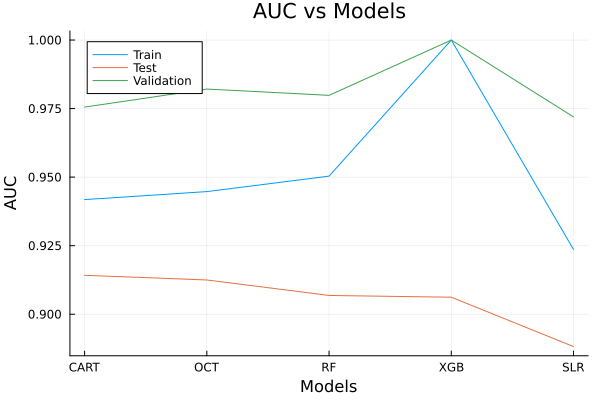

In [ ]:
train_auc = [cart_train_auc, oct_train_auc, rf_train_auc, xgb_train_auc, sparse_train_auc]
test_auc = [cart_test_auc, oct_test_auc, rf_test_auc, xgb_test_auc, sparse_test_auc]
val_auc = [cart_val_auc, oct_val_auc, rf_val_auc, xgb_val_auc, sparse_val_auc]

plot(["CART", "OCT", "RF", "XGB", "SLR"], train_auc, label="Train")
plot!(["CART", "OCT", "RF", "XGB", "SLR"], test_auc, label="Test")
plot!(["CART", "OCT", "RF", "XGB", "SLR"], val_auc, label="Validation")
plot!(xlabel="Models", ylabel="AUC", title="AUC vs Models", legend=:topleft)

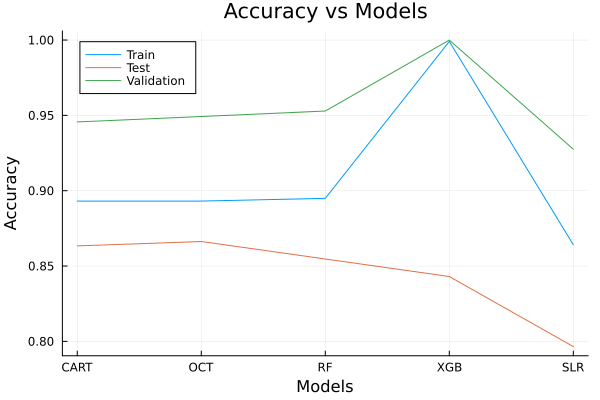

In [ ]:
train_acc = [cart_train_acc, oct_train_acc, rf_train_acc, xgb_train_acc, sparse_train_acc]
test_acc = [cart_test_acc, oct_test_acc, rf_test_acc, xgb_test_acc, sparse_test_acc]
val_acc = [cart_val_acc, oct_val_acc, rf_val_acc, xgb_val_acc, sparse_val_acc]

plot(["CART", "OCT", "RF", "XGB", "SLR"], train_acc, label="Train")
plot!(["CART", "OCT", "RF", "XGB", "SLR"], test_acc, label="Test")
plot!(["CART", "OCT", "RF", "XGB", "SLR"], val_acc, label="Validation")
plot!(xlabel="Models", ylabel="Accuracy", title="Accuracy vs Models", legend=:topleft)
